<a href="https://colab.research.google.com/github/afvallejo/covid_DC/blob/main/3_Annotattion_Immunecells_from_Skin.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

## link Gdrive

In [ ]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


In [ ]:
!mkdir MyDrive   
!mount --bind /content/drive/My\ Drive /content/MyDrive

# Installing Cello

you may skip ths if no automatic anotation is needed.

In [ ]:
pip install cffi==1.14.6

In [ ]:
!pip install pynndescent
!pip install -q condacolab
import condacolab
condacolab.install()

!conda install -y graphviz
!pip install cffi==1.14.6
!pip install pygraphviz
!pip install leidenalg
!pip install umap-learn==0.5.1
!pip install scanpy
!pip install cello-classify
import umap
umap.__version__ = '0.5.1'


# Installing packages in Colab

In [ ]:
%cd /content/

/content


In [ ]:
import gdown
#https://drive.google.com/uc?id=
gdown.download(url="https://drive.google.com/uc?id=17OU7OpLv-v_0tE-41HsWIxge4rs22YpR", 
               output="scanpy.zip", quiet=False)

Downloading...
From: https://drive.google.com/uc?id=17OU7OpLv-v_0tE-41HsWIxge4rs22YpR
To: /content/scanpy.zip
100%|██████████| 12.7M/12.7M [00:00<00:00, 54.2MB/s]


'scanpy.zip'

In [ ]:
!cp /content/MyDrive/tools/scanpy.zip /content/

In [ ]:
%%capture
!unzip /content/scanpy.zip

In [ ]:
pip install setuptools-scm install scanpy anndata leidenalg scrublet bbknn umap-learn==0.5.1

     |████████████████████████████████| 80 kB 6.5 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.1-py3-none-any.whl size=76564 sha256=9d603626371d045b8d48927f68fd460397f72084b1772d34d1bee09251a26729
  Stored in directory: /root/.cache/pip/wheels/01/e7/bb/347dc0e510803d7116a13d592b10cc68262da56a8eec4dd72f
Successfully built umap-learn
  Attempting uninstall: umap-learn
    Found existing installation: umap-learn 0.5.2
    Uninstalling umap-learn-0.5.2:
      Successfully uninstalled umap-learn-0.5.2


In [ ]:
import os
os.environ["FLIT_ROOT_INSTALL"] = "1"

In [ ]:
!python3 -m pip install flit

     |████████████████████████████████| 49 kB 4.7 MB/s 
     |████████████████████████████████| 45 kB 3.4 MB/s 


In [ ]:
%cd /content/scanpy-02b091a02a6bc962ee83ebeea85bffe8746f1859

/content/scanpy-02b091a02a6bc962ee83ebeea85bffe8746f1859


In [ ]:
!flit install -s --deps=develop

>Fetching list of valid trove classifiers                         I-flit.validate
Extras to install for deps 'develop': {'dev', '.none', 'test', 'doc'}  I-flit.install
Installing requirements                                           I-flit.install
     |████████████████████████████████| 156 kB 14.1 MB/s 
     |████████████████████████████████| 280 kB 74.6 MB/s 
     |████████████████████████████████| 132 kB 73.2 MB/s 
     |████████████████████████████████| 146 kB 70.2 MB/s 
     |████████████████████████████████| 193 kB 79.2 MB/s 
     |████████████████████████████████| 3.1 MB 57.9 MB/s 
     |████████████████████████████████| 2.8 MB 72.7 MB/s 
     |████████████████████████████████| 843 kB 72.0 MB/s 
     |████████████████████████████████| 90 kB 9.9 MB/s 
     |████████████████████████████████| 121 kB 76.8 MB/s 
     |████████████████████████████████| 84 kB 3.6 MB/s 
     |████████████████████████████████| 100 kB 9.0 MB/s 
     |████████████████████████████████| 6.2 MB 71.4 MB/s 
 

## Load packages

In [ ]:
import scanpy as sc
import numpy as np
import re
import pandas as pd
import seaborn as sb
import matplotlib
import matplotlib.pyplot as pl
import scanpy.external as sce
from matplotlib import colors
import bbknn
sc._settings.ScanpyConfig.n_jobs=8

pl.rcParams['pdf.fonttype'] = 'truetype'
sc.set_figure_params(vector_friendly=False,dpi_save=300,transparent=True)
pl.rcParams['lines.linewidth'] = 0.1
sc.set_figure_params(color_map='viridis')
colorsComb = np.vstack([pl.cm.Reds(np.linspace(0, 1, 10)), pl.cm.Greys_r(np.linspace(0.7, 0.8, 0))])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

#cello_resource_loc = os.getcwd()
cello_resource_loc = "."


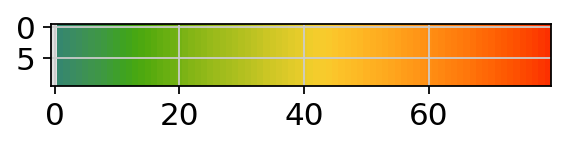

In [ ]:
import colorcet as cc

xs, _ = np.meshgrid(np.linspace(0, 1, 80), np.linspace(0, 1, 10))
colorsComb = np.vstack([pl.cm.Greys_r(np.linspace(0.8,0.1, 1)), cc.cm.rainbow_bgyr_35_85_c72(np.linspace(0.2,1, 100))])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)
pl.imshow(xs, cmap=mymap);  # use tab completion to choose

# Setup

## set WD

In [ ]:
folder='/content/'

samplename='CTR'
random_state=42

import os
os.chdir(folder)
if not os.path.exists('./figures'):
    os.makedirs('./figures')

# Download the data

In [ ]:
import gdown
gdown.download(url="https://drive.google.com//uc?id=1isVjW6cFPwK87Ze4Cu8XBm1RXURiAWTR", 
               output="APC_clean.h5ad", quiet=False)


Downloading...
From: https://drive.google.com//uc?id=1isVjW6cFPwK87Ze4Cu8XBm1RXURiAWTR
To: /content/APC_clean.h5ad
100%|██████████| 1.86G/1.86G [00:09<00:00, 190MB/s]


'APC_clean.h5ad'

In [ ]:
adata = sc.read('APC_clean.h5ad')
adata

AnnData object with n_obs × n_vars = 61590 × 33538
    obs: 'Status', 'Site', 'Tissue', 'Enrichment', 'Location', 'donor_id', 'Sex', 'Age', 'stage', 'final_clustering'

# QC

In [ ]:
# Quality control - calculate QC covariates
adata.obs['n_counts'] = adata.X.sum(1)
adata.obs['log_counts'] = np.log(adata.obs['n_counts'])
adata.obs['n_genes'] = (adata.X > 0).sum(1)



# compute qc metrics
regex = re.compile('^(MT-).*', re.IGNORECASE)
mito_genes = [l for l in adata.var_names for m in [regex.search(l)] if m]
adata.var['mito'] = False
adata.var.loc[mito_genes, 'mito'] = True
adata.obs['mt_frac'] = np.sum(
    adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1
print('Found {} mito genes and annotated.'.format(len(mito_genes)))

sc.pp.calculate_qc_metrics(adata, qc_vars=['mito'], inplace=True)


adata

Found 13 mito genes and annotated.


/usr/local/lib/python3.7/dist-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  warnings.warn(problem)


AnnData object with n_obs × n_vars = 61579 × 33538
    obs: 'Status', 'Site', 'Tissue', 'Enrichment', 'Location', 'donor_id', 'Sex', 'Age', 'stage', 'final_clustering', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito'
    var: 'mito', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [ ]:
print(adata.obs['Status'].value_counts())

Healthy      35654
Eczema       13367
Psoriasis    11479
Name: Status, dtype: int64


In [ ]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, min_counts = 200)
print('Number of cells after min count filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, max_counts = 50000)
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

adata = adata[adata.obs['mt_frac'] < 0.3]
print('Number of cells after MT filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, min_genes = 250)
print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 61579
Number of cells after min count filter: 61579
Number of cells after max count filter: 61579
Number of cells after MT filter: 60500


Trying to set attribute `.obs` of view, copying.


Number of cells after gene filter: 60500


In [ ]:
sc.pp.filter_genes(adata, min_cells=3)


In [ ]:
adata.layers["counts"]=adata.X

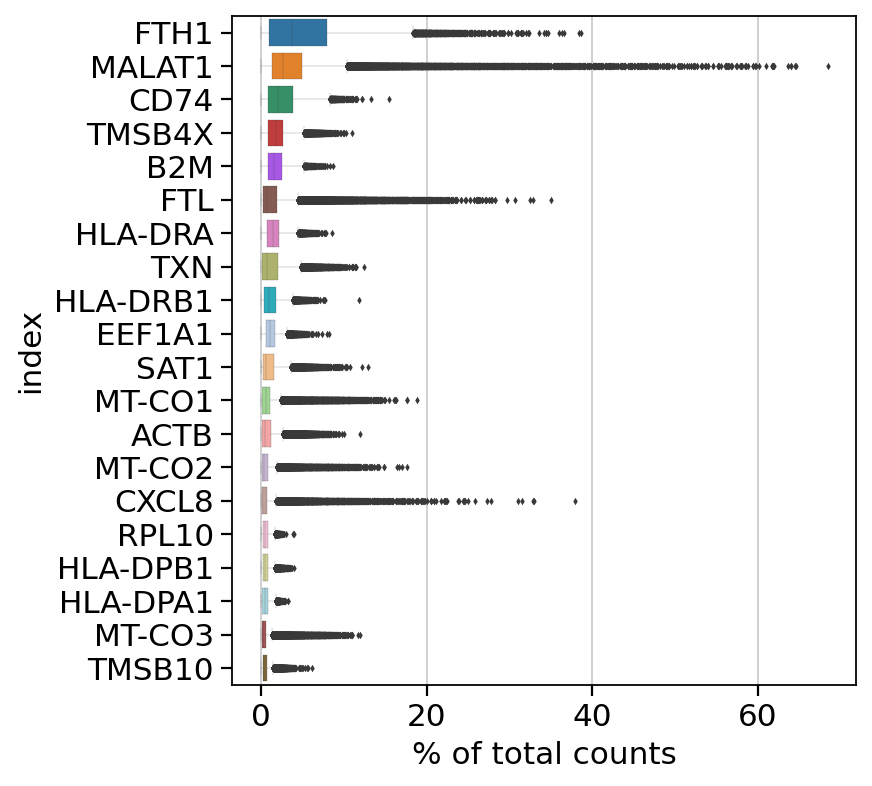

In [ ]:
sb.set_context('paper')
pl.rcParams['pdf.fonttype'] = 'truetype'
sc.set_figure_params(vector_friendly=False,dpi_save=300,transparent=True)
pl.rcParams['lines.linewidth'] = 0.1
sc.pl.highest_expr_genes(adata, n_top=20,save='top20_shortreads.pdf' )

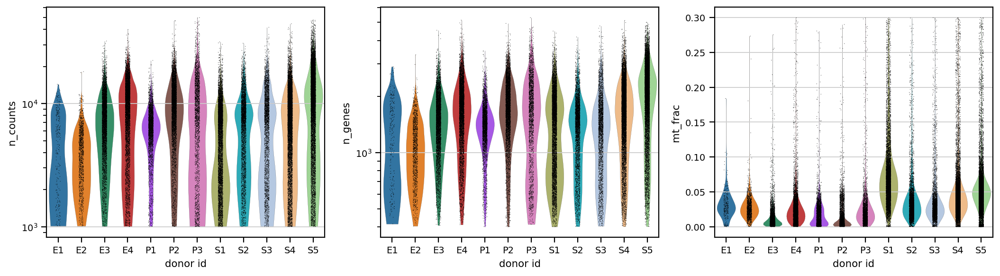

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16,4), gridspec_kw={'wspace':0.2})

ax1_dict = sc.pl.violin(adata, 'n_counts', groupby='donor_id', size=0.5, log=True, cut=0, ax=ax1, show=False)
ax2_dict =  sc.pl.violin(adata, 'n_genes', groupby='donor_id', size=0.5, log=True, cut=0, ax=ax2, show=False)
ax3_dict = sc.pl.violin(adata, 'mt_frac', groupby='donor_id',size=0.5, ax=ax3, show=False,)
savefig='figures/'+samplename + '_1_QC_violin_plots.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

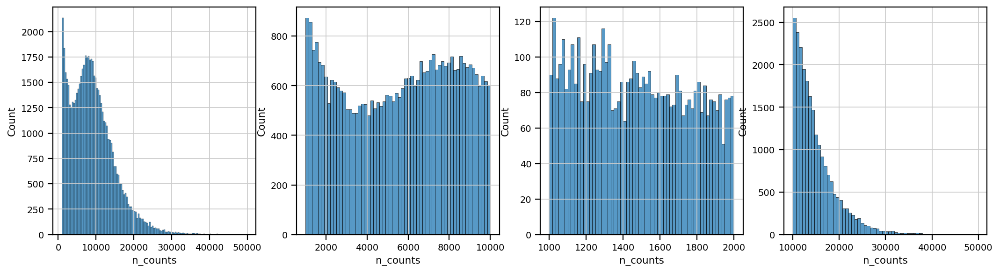

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3,ax4) = plt.subplots(1, 4, figsize=(16,4), gridspec_kw={'wspace':0.2})

ax1_dict = sb.histplot(adata.obs['n_counts'], kde=False, ax=ax1,)
ax2_dict =  sb.histplot(adata.obs['n_counts'][adata.obs['n_counts']<10000], kde=False, bins=60, ax=ax2,)
ax3_dict =  sb.histplot(adata.obs['n_counts'][adata.obs['n_counts']<2000], kde=False, bins=60, ax=ax3,)
ax4_dict = sb.histplot(adata.obs['n_counts'][adata.obs['n_counts']>10000], kde=False, bins=60, ax=ax4, )
savefig='figures/'+samplename + '_2_QC_counts_filtering.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

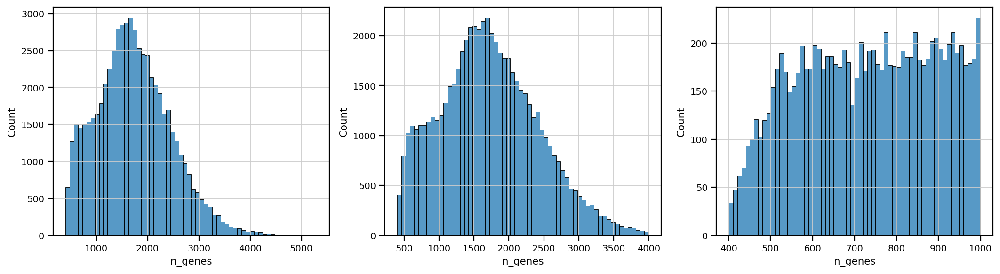

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16,4), gridspec_kw={'wspace':0.2})

ax1_dict = sb.histplot(adata.obs['n_genes'], kde=False, bins=60, ax=ax1,)
ax2_dict =  sb.histplot(adata.obs['n_genes'][adata.obs['n_genes']<4000], kde=False, bins=60, ax=ax2,)
ax3_dict =  sb.histplot(adata.obs['n_genes'][adata.obs['n_genes']<1000], kde=False, bins=60, ax=ax3,)
savefig='figures/'+samplename + '_3_QC_gene_filtering.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

In [ ]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata.n_obs))

#sc.pp.filter_cells(adata, min_counts = 2000)
#print('Number of cells after min count filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, max_counts = 50000)
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

adata = adata[adata.obs['mt_frac'] < 0.3]
print('Number of cells after MT filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, min_genes = 250)
print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 60500
Number of cells after max count filter: 60500
Number of cells after MT filter: 60500


Trying to set attribute `.obs` of view, copying.


Number of cells after gene filter: 60500


In [ ]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 5 cells - filters out 0 count genes
sc.pp.filter_genes(adata, min_cells=5)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 33538
Number of genes after cell filter: 21178


In [ ]:
adata.layers["raw"] = adata.X.copy()
adata.layers["sqrt_norm"] = np.sqrt(
    sc.pp.normalize_total(adata, inplace=False)["X"])

# Normalization

In [ ]:
sc.experimental.pp.recipe_pearson_residuals(adata,n_top_genes=2000,n_comps=100,random_state=42,inplace=True,)
#sc.experimental.pp.recipe_pearson_residuals(adata,n_top_genes=2000,n_comps=100,random_state=42,inplace=True,batch_key= 'sample')
adata

AnnData object with n_obs × n_vars = 60500 × 21178
    obs: 'Status', 'Site', 'Tissue', 'Enrichment', 'Location', 'donor_id', 'Sex', 'Age', 'stage', 'final_clustering', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito'
    var: 'mito', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable'
    uns: 'donor_id_colors', 'hvg', 'pca', 'pearson_residuals_normalization'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'raw', 'sqrt_norm'

In [ ]:
adata.layers["normalized"]=adata.X

## Removal of Mitochondrial and Ribosomal Protein Genes

In [ ]:
ribo_genes = adata.var_names.str.startswith(("RPS","RPL"))
mito_genes = adata.var_names.str.startswith('MT-')
malat1 = adata.var_names.str.startswith('MALAT1')
remove = np.add(ribo_genes,mito_genes)
remove = np.add(remove,malat1)
kept_genes = np.invert(remove)

In [ ]:
adata = adata[:,kept_genes]

Trying to set attribute `._uns` of view, copying.


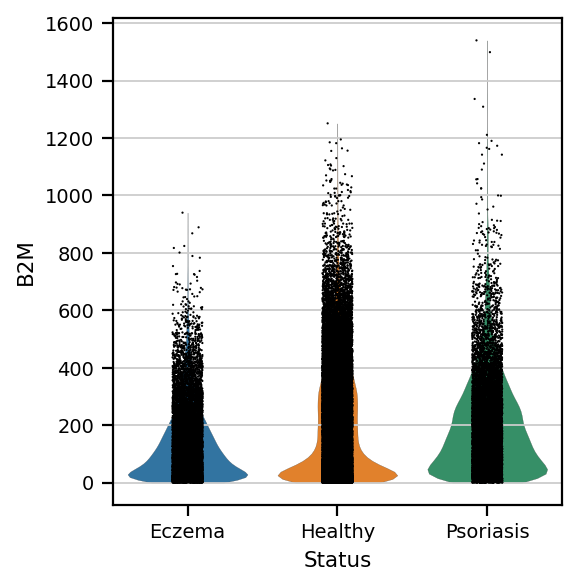

In [ ]:
sc.pl.violin(adata, ['B2M'],groupby='Status')

In [ ]:
adata.layers["normalized"]=adata.X
sc.pp.log1p(adata)
adata.layers["logcounts"] = adata.X

In [ ]:
#sc.pl.violin(adata, ['B2M'],groupby='sample',)

In [ ]:
# Store the full data set in 'raw' as log-normalised data for statistical testing
#adata.raw = adata

In [ ]:
normalized=samplename+"_normalized.h5ad"
print(normalized)
adata.write(normalized)


CTR_normalized.h5ad


In [ ]:
normalized=samplename+"_normalized.h5ad"
adata=sc.read(normalized)
adata

AnnData object with n_obs × n_vars = 8152 × 21057
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet'
    var: 'gene_ids', 'feature_types', 'mito', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable'
    uns: 'hvg', 'pca', 'pearson_residuals_normalization', 'sample_colors', 'scrublet'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'counts', 'logcounts', 'normalized', 'raw', 'sqrt_norm'

# PCA

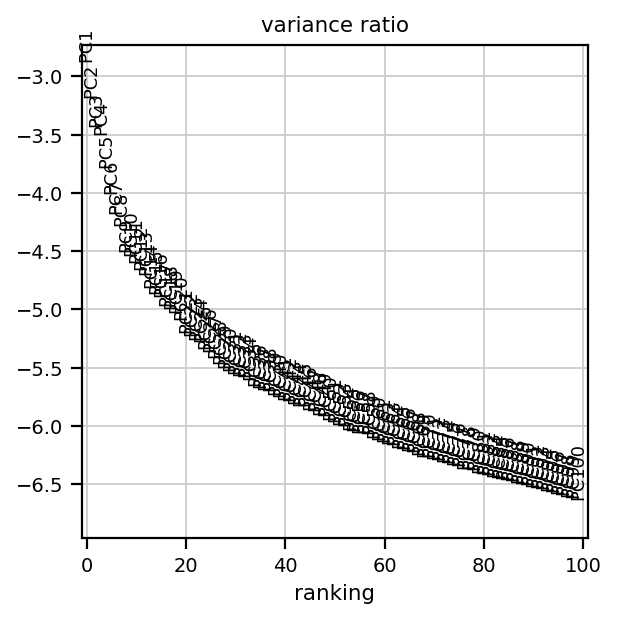

In [ ]:
sc.pl.pca_variance_ratio(adata, n_pcs = 100,log=True)

In [ ]:
####################################
# for using with corrected counts as X only
####################################
#sc.pp.scale(adata,max_value=10)

In [ ]:
#sc.pp.pca(adata, n_comps = 100, use_highly_variable =True, svd_solver = "arpack")
#sc.pl.pca_variance_ratio(adata, n_pcs = 100,log=True)

In [ ]:
#sce.pp.bbknn(adata,batch_key='Group', n_pcs = 100,metric='angular')
#'angular', 'euclidean', 'manhattan', and 'hamming'
#sce.pp.mnn_correct(adata,batch_key='run')

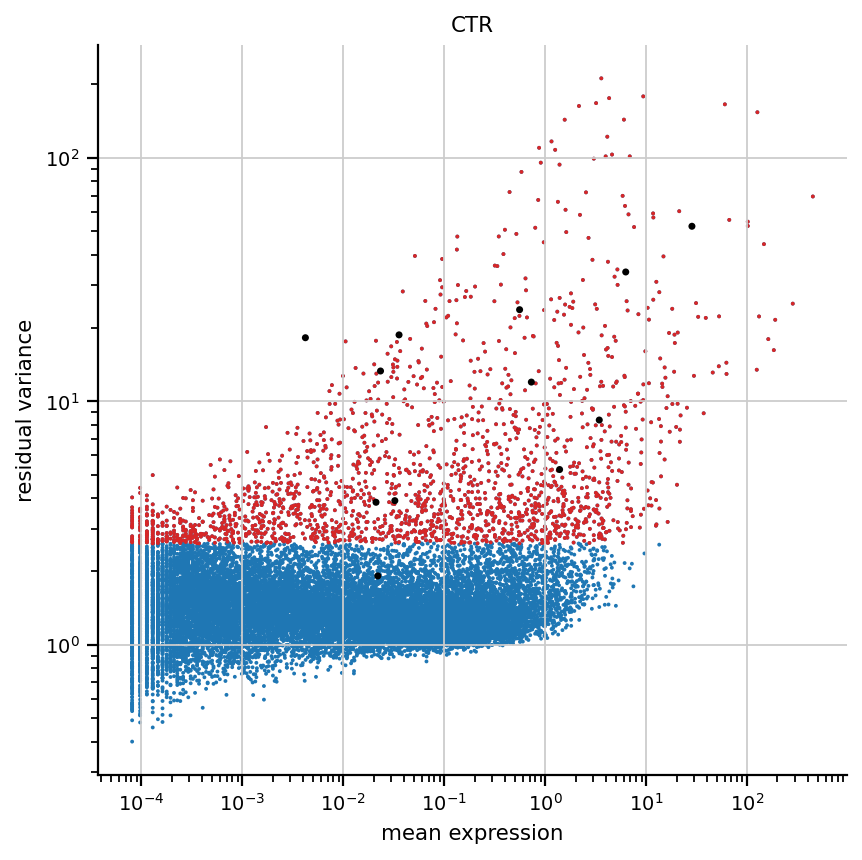

In [ ]:
markers = ["IL7R","LYZ","CD14","MS4A1","CD8A","GNLY","NKG7","FCGR3A","MS4A7","FCER1A","CST3","PPBP",]
hvgs = adata.var["highly_variable"]
fig, ax = plt.subplots(figsize=(6, 6))
pl.scatter(
        adata.var["mean_counts"], adata.var["residual_variances"], s=3, edgecolor="none"
    )
pl.scatter(
        adata.var["mean_counts"][hvgs],
        adata.var["residual_variances"][hvgs],
        c="tab:red",
        label="selected genes",
        s=3,
        edgecolor="none",
    )
pl.scatter(
        adata.var["mean_counts"][np.isin(adata.var_names, markers)],
        adata.var["residual_variances"][np.isin(adata.var_names, markers)],
        c="k",
        label="known marker genes",
        s=10,
        edgecolor="none",
    )
ax.set_xscale("log")
ax.set_xlabel("mean expression")
ax.set_yscale("log")
ax.set_ylabel("residual variance")
ax.set_title(samplename)

ax.spines["right"].set_visible(False)
ax.spines["top"].set_visible(False)
ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")

In [ ]:
adata

AnnData object with n_obs × n_vars = 60500 × 21063
    obs: 'Status', 'Site', 'Tissue', 'Enrichment', 'Location', 'donor_id', 'Sex', 'Age', 'stage', 'final_clustering', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito'
    var: 'mito', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable'
    uns: 'donor_id_colors', 'hvg', 'pca', 'pearson_residuals_normalization', 'Status_colors', 'log1p'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'raw', 'sqrt_norm', 'normalized', 'logcounts'

# Neighbors and clustering

In [ ]:
sc.pp.neighbors(adata, n_pcs=50,n_neighbors=10,random_state=random_state)
#bbknn.bbknn(adata,batch_key = "sample", neighbors_within_batch =20, n_pcs = 100)


/root/.local/lib/python3.7/site-packages/scanpy/tools/_tsne.py:115: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  "In previous versions of scanpy, calling tsne with n_jobs > 1 would use "
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


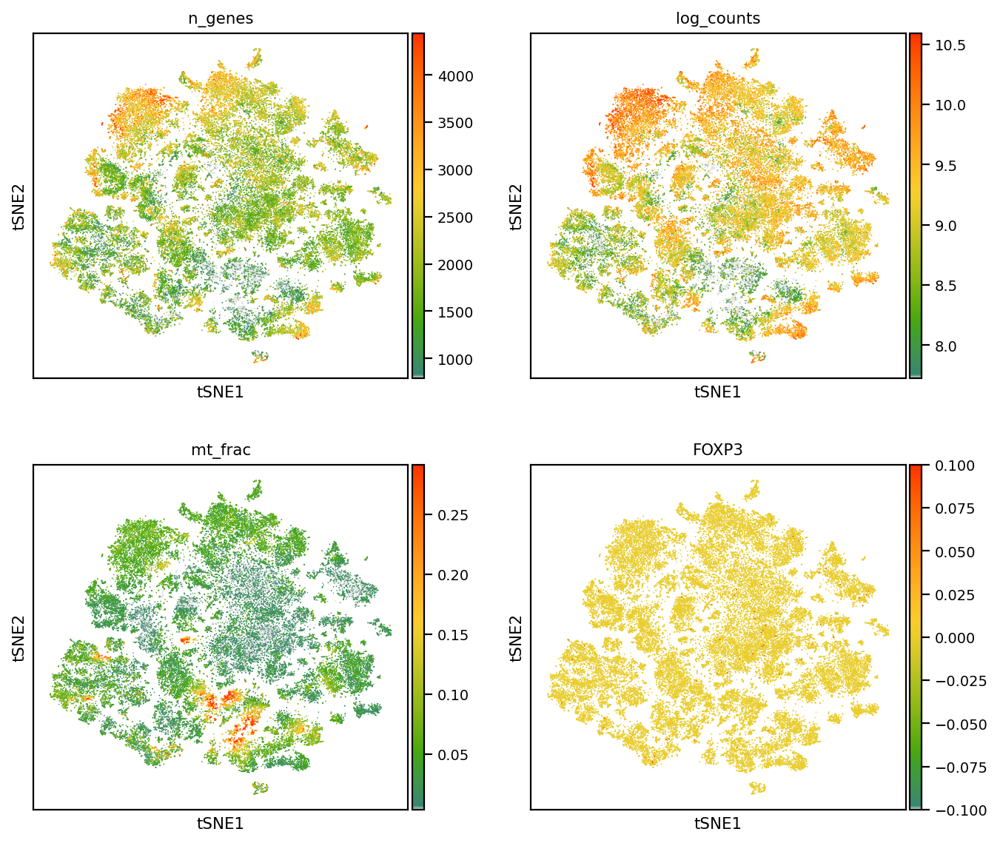

In [ ]:
genes_to_plot = ['n_genes','log_counts','mt_frac','FOXP3']
sc.tl.tsne(adata,random_state=42) 
sc.tl.umap(adata,random_state=42)
savefig="_4_QC_doublets_vst_mito.pdf"
sc.pl.tsne(adata, color = genes_to_plot,ncols=2,cmap=mymap,vmin='p10',vmax='p99.9',save=savefig)

# Clustering

In [ ]:
sc.tl.leiden(adata,random_state=random_state,resolution=1.5, key_added='leiden_r1.5')
sc.tl.leiden(adata,random_state=random_state,resolution=1, key_added='leiden_r1')
sc.tl.leiden(adata,random_state=random_state, resolution=0.8, key_added='leiden_r0.8')
sc.tl.leiden(adata,random_state=random_state, resolution=0.5, key_added='leiden_r0.5')
sc.tl.leiden(adata,random_state=random_state, resolution=0.4, key_added='leiden_r0.4')
sc.tl.leiden(adata,random_state=random_state, resolution=0.3, key_added='leiden_r0.3')
sc.tl.leiden(adata,random_state=random_state, resolution=0.2, key_added='leiden_r0.2')

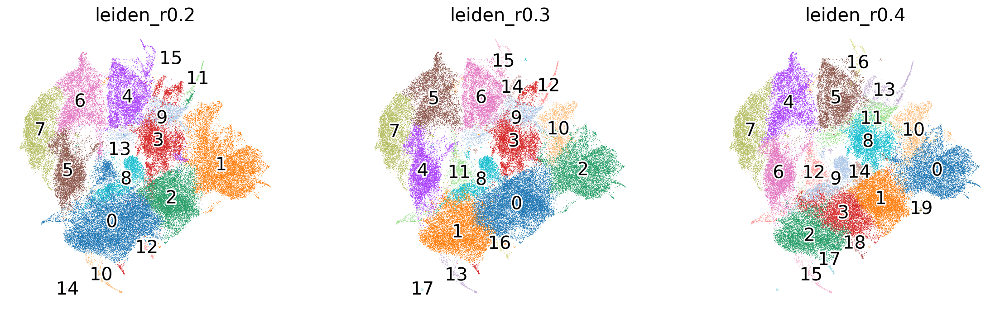

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_5_clustering_vst_lowres.pdf"
sc.pl.umap(adata, color=['leiden_r0.2','leiden_r0.3','leiden_r0.4'], legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',frameon=False,save=savefig)

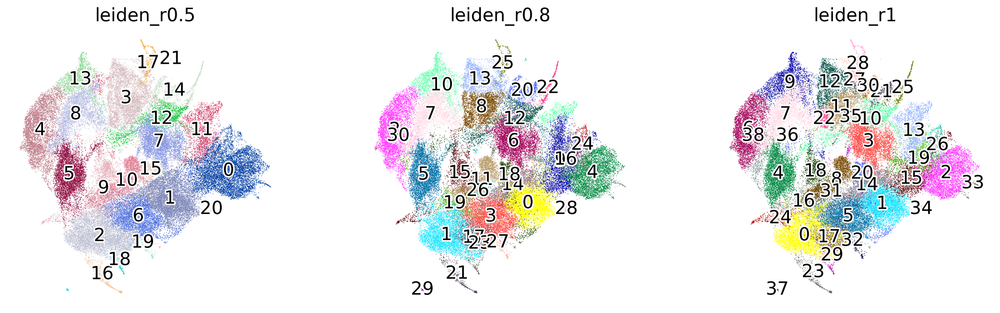

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_6_clustering_vst_hires.pdf"
sc.pl.umap(adata, color=['leiden_r0.5','leiden_r0.8','leiden_r1'], legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',frameon=False,save=savefig)

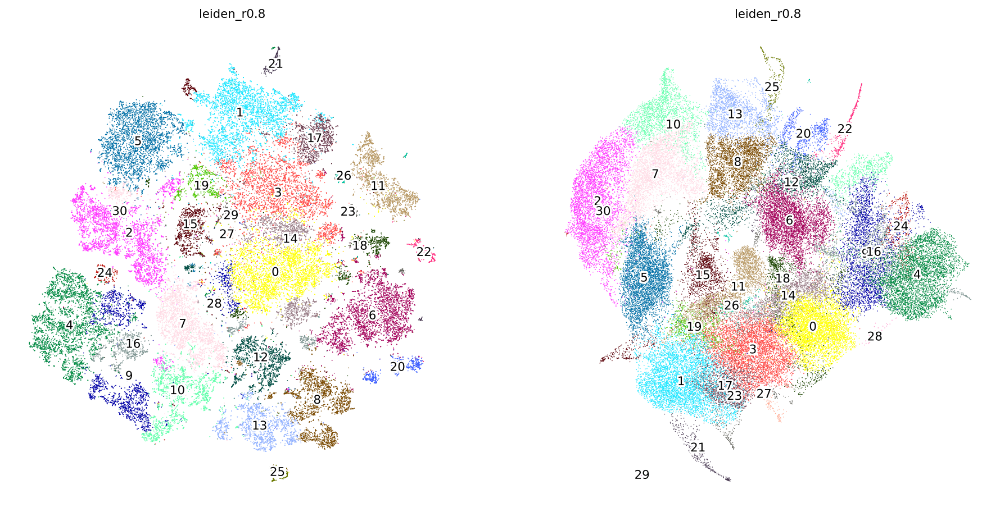

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2,) = plt.subplots(1, 2, figsize=(14,7), gridspec_kw={'wspace':0.2})

ax1_dict = sc.pl.tsne(adata, color=['leiden_r0.8'], legend_loc='on data',vmin='p10',vmax='p99.9', legend_fontoutline=3,legend_fontweight='normal',frameon=False,cmap=mymap,show=False,ax=ax1)
ax2_dict = sc.pl.umap(adata, color=['leiden_r0.8'], legend_loc='on data',legend_fontoutline=3,vmin='p10',vmax='p99.9', legend_fontweight='normal',frameon=False,cmap=mymap,show=False,ax=ax2)
savefig='figures/'+samplename + 'QC_tsne_umap_leidenr0.8.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2,) = plt.subplots(1, 2, figsize=(14,7), gridspec_kw={'wspace':0.2})

ax1_dict = sc.pl.tsne(adata, color=['FOXP3'], legend_loc='on data',vmin='p10',vmax='p99.9', legend_fontweight='normal',frameon=False,cmap=mymap,show=False,ax=ax1)
ax2_dict = sc.pl.umap(adata, color=['FOXP3'], legend_loc='on data',legend_fontoutline=3,vmin='p10',vmax='p99.9', legend_fontweight='normal',frameon=False,cmap=mymap,show=False,ax=ax2)
savefig='figures/'+samplename + 'QC_tsne_umap_FOXP3.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

In [ ]:
sc.tl.leiden(adata, resolution=0.1, restrict_to=('leiden_r0.3', ['3']),key_added='leidenA')
sc.tl.leiden(adata, resolution=0.2, restrict_to=('leidenA', ['1']),key_added='leidenB')

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_7_clustering.pdf"
sc.pl.umap(adata, color=['leidenB'],legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',frameon=False,save=savefig)

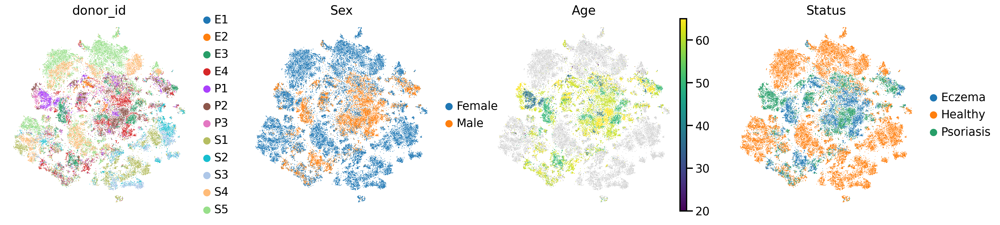

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_8_clustering_variables.pdf"
sc.pl.tsne(adata, color=['donor_id', 'Sex', 'Age', 'Status',], legend_fontoutline=3, legend_fontweight='normal',frameon=False,save=savefig)

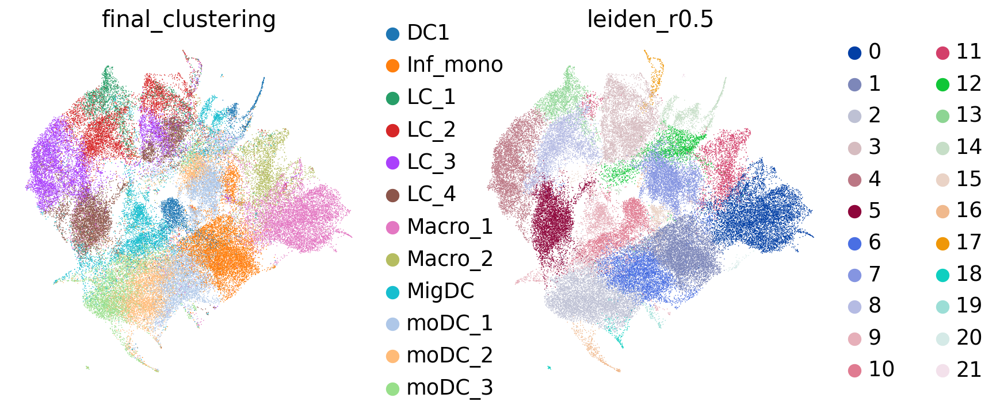

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_8_clustering_variables.pdf"
sc.pl.umap(adata, color=['final_clustering','leiden_r0.5'], legend_fontoutline=3, legend_fontweight='normal',frameon=False,save=savefig)

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2,) = pl.subplots(1, 2, figsize=(10,5), gridspec_kw={'wspace':0.2})

ax1_dict = sc.pl.umap(adata, color='sample', groups=['CTR'], ax=ax1, show=False)
ax2_dict =  sc.pl.umap(adata, color='sample', groups=['LPS'], ax=ax2, show=False)
savefig='figures/'+samplename + '_9_dataintegration.pdf'
fig.savefig(savefig, dpi=300, bbox_inches='tight')

In [ ]:
#ax = sc.pl.umap(adata, size=10, show=False)
#sc.pl.umap(adata[adata.obs["donnor"] == "D1"],color=[ 'condition'],ax=ax)

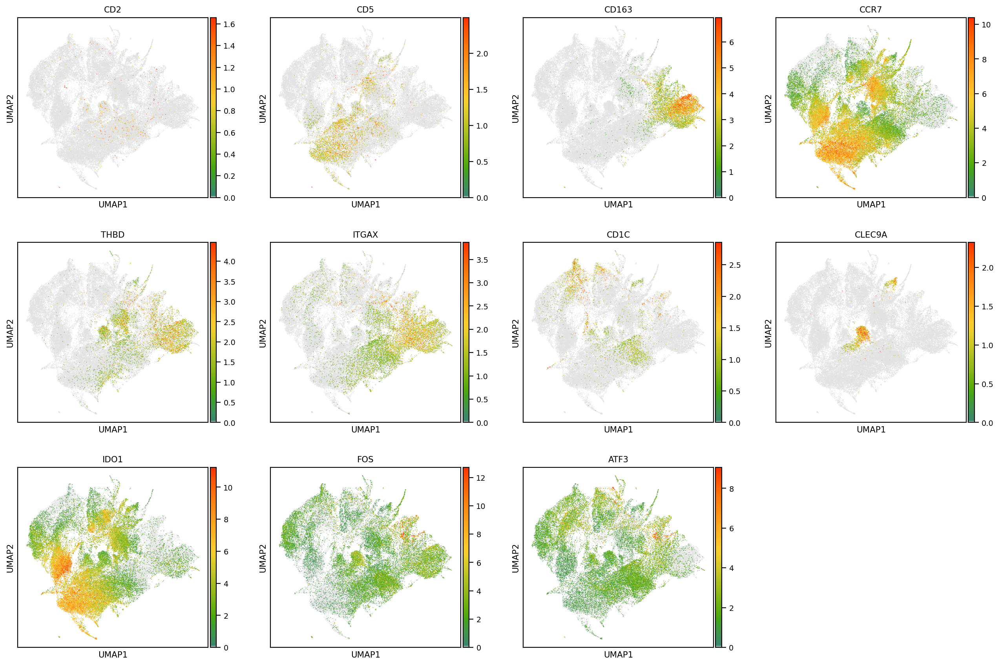

In [ ]:
marker_genes = ['CD2','CD5','CD163','CCR7','THBD','ITGAX','CD1C','CLEC9A','IDO1','FOS','ATF3']
sb.set_context('paper')
pl.rcParams['figure.figsize']=(4,4) #rescale figures
savefig=samplename+"_10_markers_4.pdf"
sc.pl.umap(adata=adata, color=marker_genes,color_map=mymap,vmin='p10', vmax='p99.9',ncols=4,
           legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',use_raw=False,layer="sqrt_norm", save=savefig)

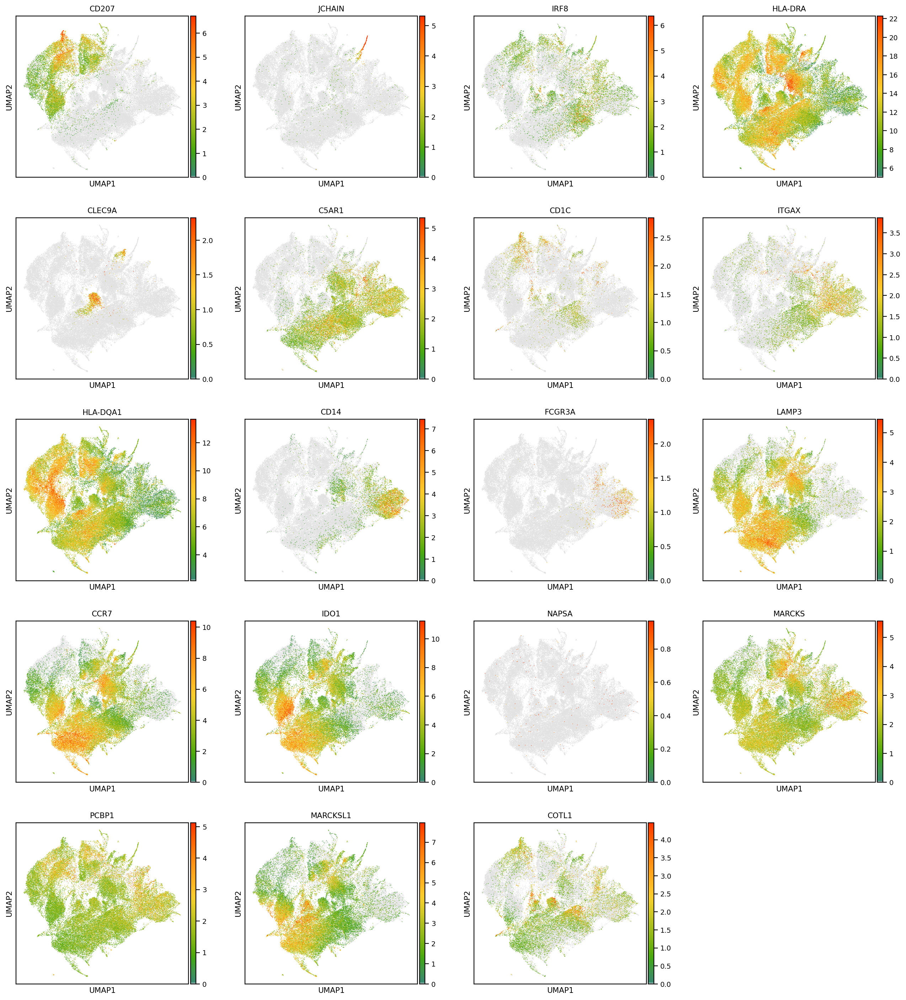

In [ ]:
marker_genes = ['CD207','JCHAIN','IRF8','HLA-DRA','CLEC9A','C5AR1','CD1C','ITGAX','HLA-DQA1','CD14','FCGR3A','LAMP3','CCR7','IDO1','NAPSA','MARCKS','PCBP1','MARCKSL1','COTL1']
sb.set_context('paper')
pl.rcParams['figure.figsize']=(4,4) #rescale figures
savefig=samplename+"_10_markers_1.pdf"
sc.pl.umap(adata=adata, color=marker_genes,color_map=mymap,vmin='p10', vmax='p99.9',ncols=4,
           legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',use_raw=False,layer="sqrt_norm", save=savefig)

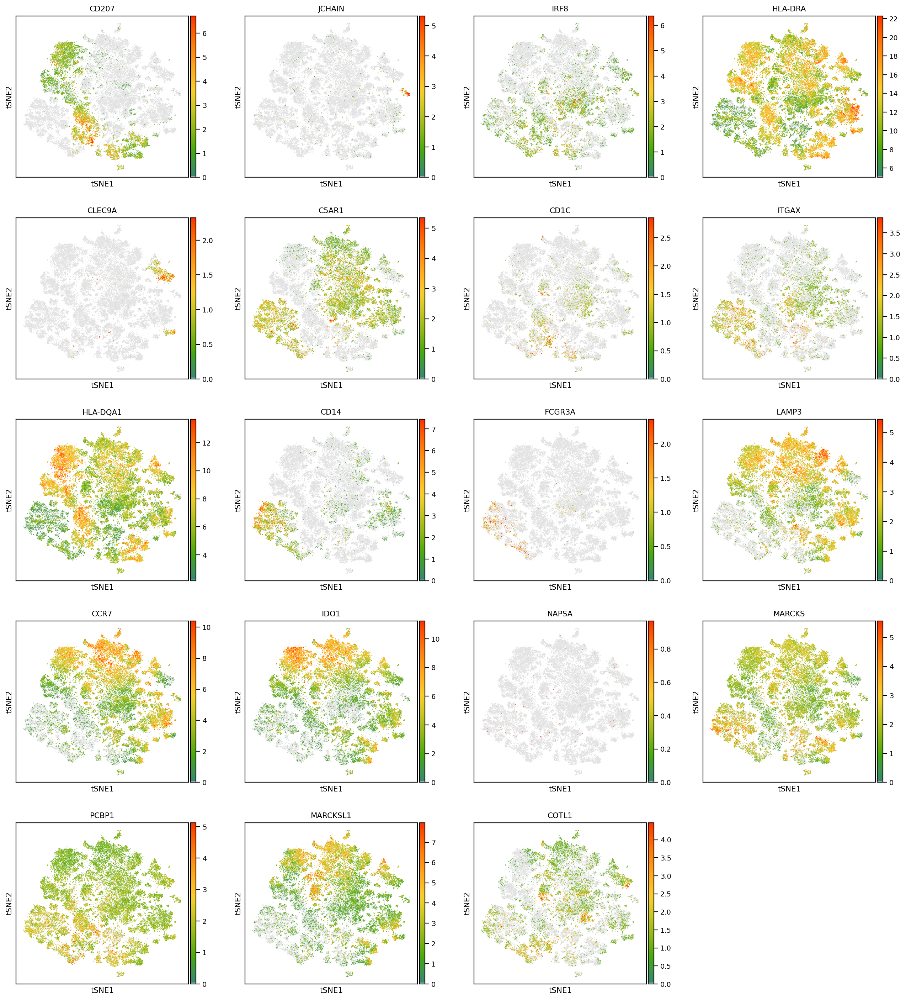

In [ ]:
marker_genes = ['CD207','JCHAIN','IRF8','HLA-DRA','CLEC9A','C5AR1','CD1C','ITGAX','HLA-DQA1','CD14','FCGR3A','LAMP3','CCR7','IDO1','NAPSA','MARCKS','PCBP1','MARCKSL1','COTL1']
sb.set_context('paper')
pl.rcParams['figure.figsize']=(4,4) #rescale figures
savefig=samplename+"_10_markers_1.pdf"
sc.pl.tsne(adata=adata, color=marker_genes,color_map=mymap,vmin='p10', vmax='p99.9',ncols=4,
           legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',use_raw=False,layer="sqrt_norm", save=savefig)

In [ ]:
marker_genes = ['JCHAIN','IRF8','HLA-DRA','CLEC9A','C5AR1','HLA-DQA1','CD14','NCAM1','NCR1', 'GNLY', 'NKG7', 'KLRB1','FCGR3A','IL7R','CD8A', 'CD8B',]
sb.set_context('paper')
pl.rcParams['figure.figsize']=(4,4) #rescale figures
savefig=samplename+"_10_markers_1.pdf"
sc.pl.umap(adata=adata, color=marker_genes,color_map=mymap,vmin='p10', vmax='p99.9',ncols=4,
           legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',use_raw=False,layer="sqrt_norm", save=savefig)

In [ ]:
cluster=samplename+"_cluster.h5ad"
adata.write(cluster)

In [ ]:
cluster=samplename+"_cluster.h5ad"
adata=sc.read(cluster)
adata

AnnData object with n_obs × n_vars = 8152 × 21057
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet', 'leiden_r1.5', 'leiden_r1', 'leiden_r0.8', 'leiden_r0.5', 'leiden_r0.4', 'leiden_r0.3', 'leiden_r0.2'
    var: 'gene_ids', 'feature_types', 'mito', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable'
    uns: 'condition_colors', 'hvg', 'leiden', 'leiden_r0.2_colors', 'leiden_r0.3_colors', 'leiden_r0.4_colors', 'leiden_r0.5_colors', 'leiden_r0.8_colors', 'leiden_r1_colors', 'neig

# Automatic annotation

In [ ]:
import cello

In [ ]:
sc.tl.leiden(adata, resolution=1.5)

In [ ]:
adata.X = adata.X.todense()

In [ ]:
adata.var_names_make_unique()
adata.var_names_make_unique()

In [ ]:
model_prefix = "DCLPS" # <-- The trained model will be stored in a file called GSM3516666_LX682_NORMAL.model.dill 

cello.scanpy_cello(
    adata, 
    'leiden',
    cello_resource_loc, 
    out_prefix=model_prefix
)

In [ ]:
model_prefix = "DCVitD3_CTR"

cello.scanpy_cello(
    adata, 
    'leiden',
    cello_resource_loc, 
    model_file=f'{model_prefix}.model.dill'
)

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(8,8)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_annotated_hires_annotated.pdf"
sc.pl.tsne(adata, color=['Most specific cell type'], legend_loc='on data',cmap=mymap,legend_fontoutline=3,vmax='p99.9',legend_fontsize='x-small', legend_fontweight='normal',frameon=False,save=savefig)

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(8,8)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_annotated_hires_annotated.pdf"
sc.pl.umap(adata, color=['Most specific cell type'], legend_loc='on data',cmap=mymap,legend_fontoutline=3,vmax='p99.9',legend_fontsize='x-small', legend_fontweight='normal',frameon=False,save=savefig)

In [ ]:
cluster=samplename+"_annotated.h5ad"
adata.write(cluster)

In [ ]:
cluster=samplename+"_annotated.h5ad"
adata=sc.read(cluster)
adata

In [ ]:
sc.pl.umap(adata, color='Most specific cell type', return_fig=True)

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
sc.pl.umap(adata, color='T cell (binary)')

# Marker genes

# Short Reads

In [ ]:
#method : {‘logreg’, ‘t-test’, ‘wilcoxon’, ‘t-test_overestim_var’} | None (default: None)
sc.tl.rank_genes_groups(adata, 'leiden_r0.5', method='logreg',n_genes=adata.shape[1])
markers=pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(50)
markers

In [ ]:
savetable=samplename+"_marker_genes_leiden_r0.5.csv"
markers.to_csv(savetable)

# Known markers

In [ ]:
adata.obs['leiden_r1'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18'],
      dtype='object')

In [ ]:
adata.obs.annotated = adata.obs.leiden_r1.cat.reorder_categories([
'3','11','12','14','2','1','6','8','9','0','5','7','10','4','13','15','16', '17', '18' ])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  


In [1]:
marker_genes_dict = {
    'pDC': ['JCHAIN','IRF8','PTPRS','RHEX',],
    'mregDC':['LAMP3','SLCO5A1','IDO1','MARCKS','CRLF2','MARCKSL1',],
    'DC3':['PLA2G7','ITGAX','FCER1G','PTPRE','DOCK4','LYZ','C15orf48','CYP1B1','STAB1','CYP27A1','GPR68','CD14'],
    'DC2':['SYT17','EDN1','CTLA4','INHBA','SPRED1','FMNL2','IL1RN',],
    'NK': ['GNLY','KLRD1','C1orf21','LINC00996','TXK','ZBTB16','NCAM1',],
    'T-cell': ['IL7R','CD3D','CD3G','LTB','CCL5','CD247'],
    'B-cell': ['CD79A', 'MS4A1','AFF3','IGKC','IGHM','BANK1']
}

In [ ]:
sb.set_context('paper')
savefig=samplename+"_Dotplot_markers_all.pdf"
sc.pl.dotplot(adata, 
                  var_names=marker_genes_dict,
                  vmin=-2, vmax=2, cmap='RdBu_r', groupby='leiden_r0.5', return_fig=False, dendrogram=False,save=savefig)

In [ ]:
sb.set_context('paper')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_clustering_hires_vst.pdf"
sc.pl.umap(adata, color=['leiden_r0.5','sample'], legend_loc='on data',legend_fontoutline=3,legend_fontsize='small', legend_fontweight='normal',frameon=False,save=savefig)

# Annotattion

In [ ]:
adata.obs['leiden_r0.3'].cat.categories

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_5_clustering_vst_lowres.pdf"
sc.pl.umap(adata, color=['leiden_r0.3','sample'], legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',frameon=False,save=savefig)

In [ ]:
adata.obs['annotated'] = adata.obs['leiden_r0.3'].cat.add_categories(['pDC','DC1','DC2_CTR','DC2_LPS','Bcells','DC_unknown','NKcells','Tcells','Mono','preDC?','innate lymphoid cells','Platelet','unknown'])

adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['2'])] = 'pDC'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['6',])] = 'DC1'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['0','11'])] = 'DC2_CTR'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['1'])] = 'DC2_LPS'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['4'])] = 'Bcells'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['3'])] = 'NKcells'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['5'])] = 'Tcells'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['12'])] = 'Mono'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['8'])] = 'preDC?'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['9'])] = 'innate lymphoid cells'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['10'])] = 'Platelet'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['13'])] = 'unknown'
adata.obs['annotated'][np.in1d(adata.obs['annotated'], ['7'])] = 'DC_unknown'

adata.obs['annotated'] = adata.obs['annotated'].cat.remove_unused_categories()

In [ ]:
sb.set_context('paper')
pl.rcParams['figure.figsize']=(7,7)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_annotated_hires_annotated.pdf"
sc.pl.umap(adata, color=['annotated','sample'], legend_loc='on data',cmap=mymap,legend_fontoutline=3,vmax='p99.9',legend_fontsize='small', legend_fontweight='normal',frameon=False,save=savefig)

In [ ]:
cluster=samplename+"_Annotated.h5ad"
adata.write(cluster)

In [ ]:
cluster=samplename+"_Annotated.h5ad"
adata=sc.read(cluster)
adata

AnnData object with n_obs × n_vars = 12477 × 36484
    obs: 'sample', 'condition', 'donnor', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'doublet_score', 'predicted_doublet', 'D1_CTR,D2_CTR,D3_CTR', 'leiden_r1.5', 'leiden_r1', 'leiden_r0.8', 'leiden_r0.5', 'leiden_r0.4', 'leiden_r0.3', 'leiden_r0.2', 'leidenA', 'leidenB', 'annotated'
    var: 'gene_ids', 'feature_types', 'mito', 'n_cells_by_counts-0', 'mean_counts-0', 'log1p_mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'log1p_total_counts-0', 'n_cells_by_counts-1', 'mean_counts-1', 'log1p_mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'log1p_total_counts-1', 'n_cells_by_counts-2', 'mean_counts-2', 'log1p_mean_counts-2', 'pct_dropou

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(5,5)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_clustering_vst_bbknn.pdf"
sc.pl.umap(adata, color=['HLA-DRA','C5AR1','FCAR','FCER1A','CD14',"CLEC9A",'CD1C','CCR7','FCGR3A','CD163','NEAT1','LCK','CD3E','LMNA'],cmap=mymap,legend_fontoutline=3, 
           hspace=0.5,wspace=0.5,legend_fontweight='normal',frameon=False,save=savefig)

In [ ]:
sb.set_context('talk')
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
savefig=samplename+"_clustering_vst_bbknn__markers03.pdf"
sc.pl.umap(adata, color=['LAMP3', 'CCR7', 'CD83', 'NUB1', 'PLAC8', 'ARAP2', 'CLEC4C', 'PTPRS',
       'DAPP1', 'SLCO5A1', 'IRF8', 'PNRC1', 'DNASE1L3', 'DUSP5', 'CERS6',
       'COL24A1', 'LINC00996', 'ANXA5', 'ETV3', 'BASP1'],size=50,cmap=mymap,legend_fontoutline=3, 
           hspace=0.5,wspace=0.5,legend_fontweight='normal',frameon=False,save=savefig)

In [ ]:
adata


In [ ]:
#PBMC marker genes
marker_genes = ['FOXP3','IDO1','IL7R', 'CD79A', 'MS4A1', 'CD4','CD8A', 'CD8B', 'LYZ', 'CD14','LGALS3', 'S100A8', 'GNLY', 'NKG7','NCR1', 'KLRB1','FCGR3A', 'MS4A7', 'FCER1A', 'CST3','HLA-DRA', 'PPBP']

In [ ]:
#Skin marker genes
marker_genes=['GATA3', 'KRTDAP', 'KRT1', 'DMKN', 'ITGA6', 'KRT14', 'KRT5', 'S100A2', 'CRYAB', 'TYRP1', 
'PTGDS', 'DCT', 'PMEL', 'FGL2', 'PMP22', 'LUM', 'APOD', 'NT5E', 'TNFAIP6', 'DCN', 
'CFD', 'RGS5', 'MGP', 'TFPI', 'CCL21', 'TFF3', 'FABP4', 'CD34', 'PECAM1', 'TM4SF1',
'SPARCL1', 'SERPINE1', 'KIT', 'TPSB2', 'TPSAB1', 'CTSG', 'GNLY', 'XCL2', 'XCL1', 
'KLRB1', 'IL7R', 'CXCR4', 'CD3E', 'CD8A', 'CD8B', 'CD7', 'CD3D', 'TRAC', 
'CD5', 'CD4', 'FOXP3', 'TIGIT', 'CD247', 'IGKC', 'IGLC2', 'IGHA1', 'GZMB', 
'JCHAIN', 'PLEK', 'ACOT7', 'HLA-DQB2', 'HLA-DQA1', 'CCR7', 'HLA-DRA', 'CXCL8', 'RNASE1', 
'CCL3','CD207','CD79A','KRT16','KRT17','KRT6A']

In [ ]:
marker_genes=['IRF4','IRF8','CD5','CD2','CADM1','CLEC9A','STMN1','GZMB','JCHAIN','LAMP3','BIRC3','CCR7','IDO1','IRF4','IRF8','TGFBI','FBP1','LGALS1','MT2A','IFIT3','IFI44','CD14','TXNIP','CD1D','CD33','CXCL8','IL1R2']

In [ ]:
print(len(marker_genes))
filter=np.in1d(marker_genes, adata.var_names)
marker_genes = list(np.array(marker_genes)[filter])
print(len(marker_genes))
marker_genes.append("leiden_r0.5")
marker_genes.append("condition")

27
27


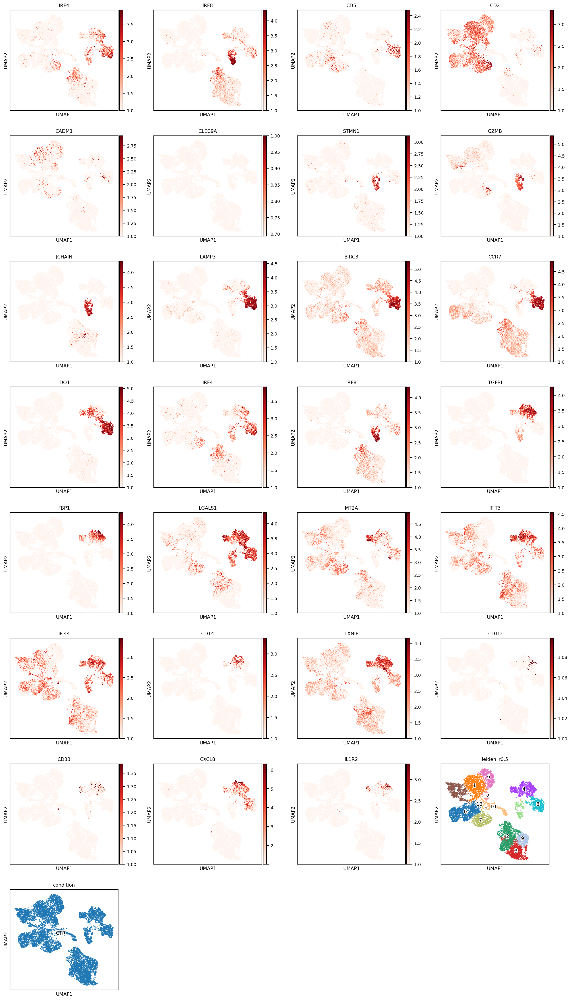

In [ ]:
sb.set_context('paper')
pl.rcParams['figure.figsize']=(4,4) #rescale figures
savefig=samplename+"_markers_vst_2.pdf"
sc.pl.umap(adata=adata, color=marker_genes,color_map=mymap,vmin=1, vmax='p99.9',ncols=4,
           legend_loc='on data',legend_fontoutline=3, legend_fontweight='normal',use_raw=True, save=savefig)

# cell cell communication

In [ ]:
pip install scConnect

In [ ]:
import scConnect as cn

In [ ]:
# set correct database ONLY RUN WHEN DATABASE HAS CHANGED
cn.database.version = "2020-5"
#cn.database.setup_database("mmusculus", receptor_types=["lgic", "vgic", "gpcr", "catalytic_receptor"])

In [ ]:
sc.pp.filter_genes(adata, min_cells=10)

In [ ]:
adata

In [ ]:
adata.X=adata.X.todense()

In [ ]:
adata_tissue = cn.genecall.meanExpression(adata, groupby="annotated", normalization=False, use_raw=False, transformation="log1p")
pd.DataFrame(adata_tissue.uns["gene_call"])

In [ ]:
adata_tissue = cn.connect.ligands(adata_tissue)
adata_tissue = cn.connect.receptors(adata_tissue)

pd.DataFrame(adata_tissue.uns["ligands"]).head(10)

In [ ]:
adata_tissue = cn.connect.specificity(adata_tissue, n=2000, groupby="annotated")
cn.connect.save_specificity(adata_tissue, "tissue_specificity.xlsx")

In [ ]:
cn.connect.load_specificity(adata_tissue, "tissue_specificity.xlsx")

In [ ]:

edges = cn.connect.interactions(emitter=adata_tissue, target=adata_tissue, self_reference=True)
nodes = cn.connect.nodes(adata_tissue)

In [ ]:
G_tissue = cn.graph.build_graph(edges, nodes)

In [ ]:
from dash import dcc

In [ ]:
pip install jupyter-dash -q

In [ ]:
from jupyter_dash import JupyterDash  # pip install dash
import dash_cytoscape as cyto  # pip install dash-cytoscape==0.2.0 or higher
import dash_html_components as html
import dash_core_components as dcc
from dash.dependencies import Output, Input
import pandas as pd  # pip install pandas
import plotly.express as px
import math
from dash import no_update

In [ ]:
cn.app.graph(G_tissue, mode="external")

In [ ]:
import dash
import dash_core_components as dcc
import dash_html_components as html
import plotly.express as px
import pandas as pd



In [ ]:
from jupyter_dash import JupyterDash

In [ ]:
!pip install pyngrok --quiet

In [ ]:
from pyngrok import ngrok
ngrok.kill()
NGROK_AUTH_TOKEN=""
ngrok.set_auth_token(NGROK_AUTH_TOKEN)

In [ ]:
%%sh
pip install -q dash
pip install -q dash_core_components
pip install -q dash_html_components
pip install -q dash_table

In [ ]:
ngrok.connect(8050)

<NgrokTunnel: "http://d34d-35-192-165-45.ngrok.io" -> "http://localhost:8050">

In [ ]:
Gs_tissue = cn.graph.split_graph(G_tissue)